# Images with Significant Background

**Scott Prahl**

**Sept 2023**

It is common to have images with significant background.  These images were all collected by students trying to do an $M^2$ experiment.

Nearly all of these require relaxing the ISO 11146 requirements for managing background.  For these images, `iso_noise=False` is passed to the analysis functions.

In [1]:
%config InlineBackend.figure_format = 'retina'

import sys
import imageio.v3 as iio
import numpy as np
import matplotlib.pyplot as plt

if sys.platform == "emscripten":
    import piplite

    await piplite.install("laserbeamsize")

import laserbeamsize as lbs

In [2]:
pixel_size_µm = 3.75  # microns

if sys.platform == "emscripten":
    repo = "images/"
else:
    repo = "https://github.com/scottprahl/laserbeamsize/raw/main/docs/images/"

## First experiment

These are 8-bit images taken by a student at various axial positions after focusing a helium-neon laser beam with a 500 mm PCX lens.  The diffraction-limited beam diameter should be

$$
d_\mathrm{waist} = \frac{4}{\pi} M^2 \lambda \frac{f} {d_\mathrm{beam}} \approx 1.27 M^2 \lambda \cdot   f\# \approx 400\mbox{ microns}
$$

if we make the assumption that the beam entering the lens is 1mm in diameter and $M^2=1$

In [3]:
f = 500  # mm
lambda0 = 633e-6  # mm
d = 1  # mm
d00 = lbs.focused_diameter(f, lambda0, d)
print("Diffraction limited beam diameter is %.0f microns" % (d00 * 1000))

Diffraction limited beam diameter is 403 microns


### Read the images into memory

In [4]:
# array of distances at which images were collected
z2 = np.array(
    [200, 300, 400, 420, 470, 490, 500, 520, 540, 550, 570, 590, 600, 650, 700, 800],
    dtype=float,
)  # mm

# array of filenames associated with each image
fn2 = [repo + "k-%dmm.png" % number for number in z2]

# read them all into memory
test_img = [iio.imread(fn) for fn in fn2]

### Find beam sizes for each image using default settings

The `lbs.beam_size()` algorithm works on these files without adjustment.  All the plots below are made using a fixed colorbar scale and the wide variation in background is noticable.  Below

[302.83339077 859.40450656] [226.42775156 552.00374626] [717.15647932 445.08141801] [156.66002779 621.77147002]
[-1043.57084211  1043.57084211] [-610.45499007  610.45499007]
[ 510.14073995 -510.14073995] [-872.08395418  872.08395418]
[315.52815365 827.69898217] [574.41394826 490.07299234] [533.08367802 610.1434578 ] [298.26597488 766.22096572]
[-960.32030347  960.32030347] [ 158.13929235 -158.13929235]
[-144.48708708  144.48708708] [-877.41560782  877.41560782]
[448.72759271 859.43768006] [416.22122114 373.09260942] [635.21844389 672.94682888] [215.01482063 574.29900994]
[-770.08141378  770.08141378] [ 80.86614697 -80.86614697]
[-70.74072186  70.74072186] [-673.65785496  673.65785496]
[452.99906533 864.49731889] [486.62634559 468.80550785] [651.11029463 666.3860896 ] [301.35039755 654.08145589]
[-771.55922542  771.55922542] [ 33.41407075 -33.41407075]
[-28.64211558  28.64211558] [-661.37073438  661.37073438]
[504.33574587 914.4795525 ] [410.37085564 441.18579318] [721.73892875 697.0763

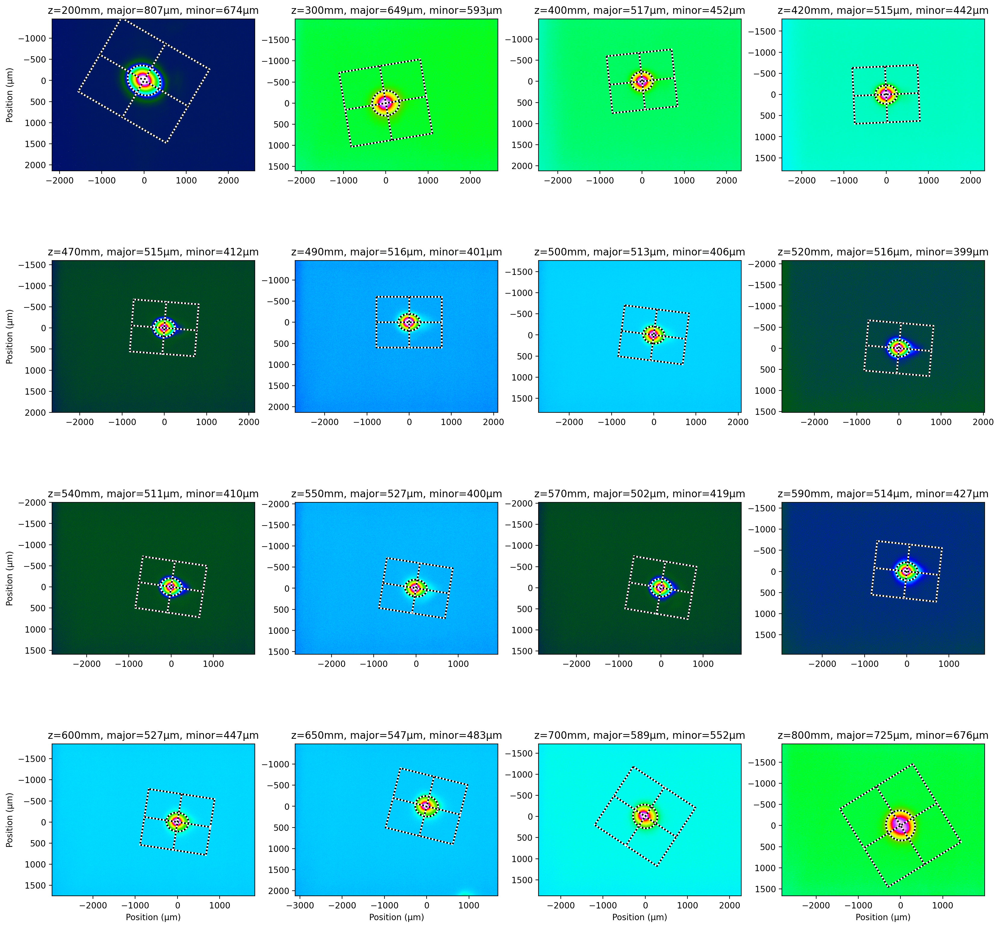

In [5]:
dx, dy = lbs.plot_image_montage(test_img, cols=4, pixel_size=pixel_size_µm, z=z2 * 1e-3, iso_noise=False)

### Image saturation

If one looks closely at the first image (z=200mm), one sees that the image was saturated in the center.  This causes the estimated beam width to be *smaller* than it should be.

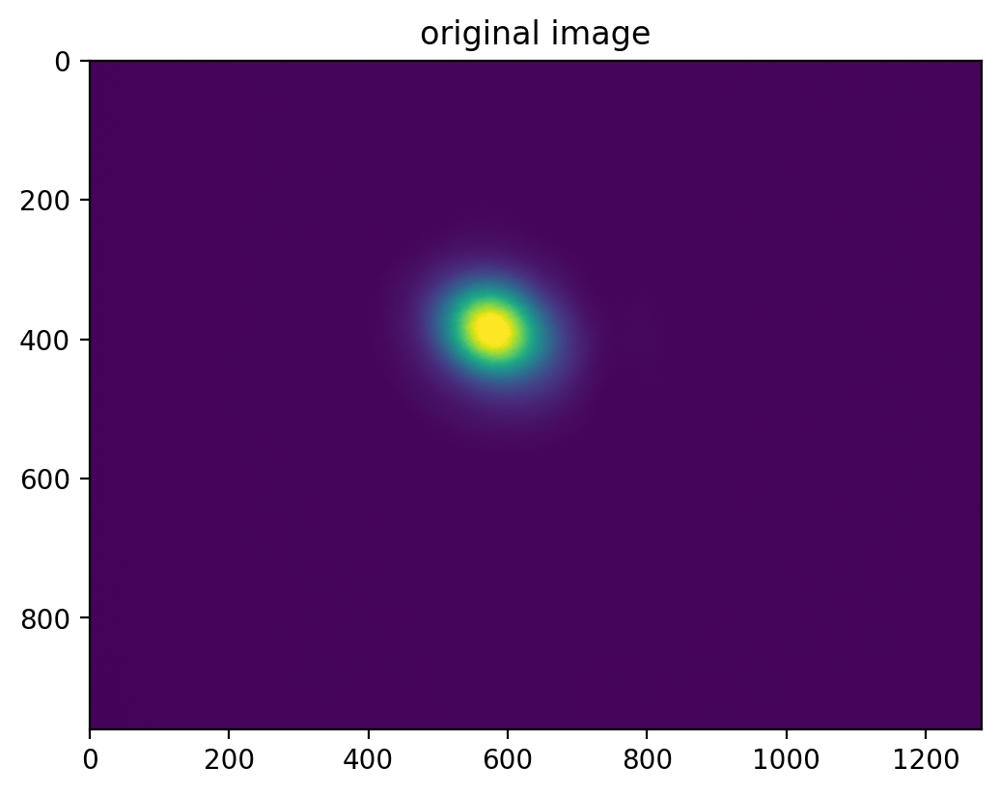

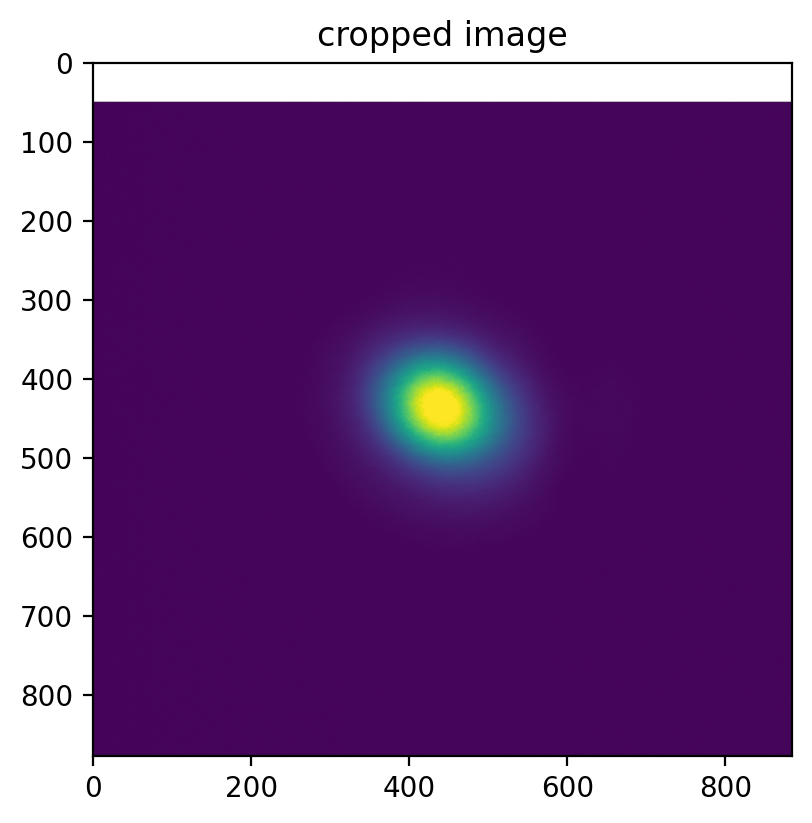

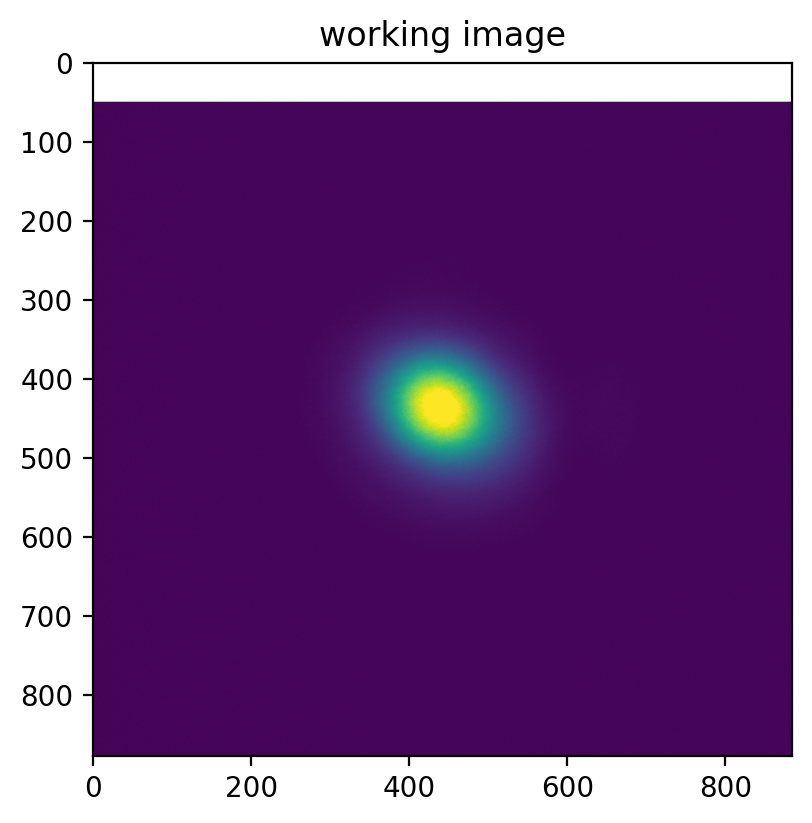

D_MINOR= 192.54507933239464
[193.00128024 693.72792861] [215.3325937  661.17218803] [635.25857308 251.47063577] [222.73446695 653.77031478]
[-938.86246568  938.86246568] [-835.94923937  835.94923937]
[ 719.60238247 -719.60238247] [-808.19221467  808.19221467]


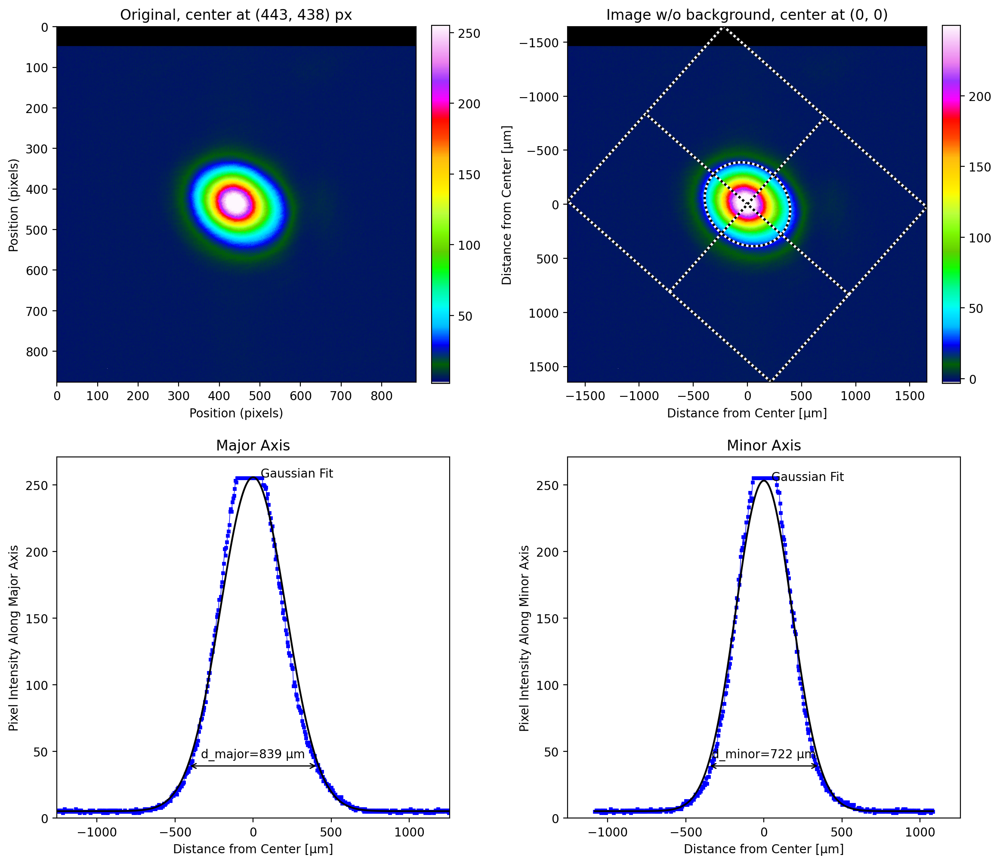

In [6]:
lbs.plot_image_analysis(test_img[0], pixel_size=pixel_size_µm, crop=True)

### Large background

If one looks closely at the last image (z=800mm), one sees that the background is nearly 100!  The algorithm does a pretty good job of ignoring the background, but again the estimated beam width is *smaller* than it should be.

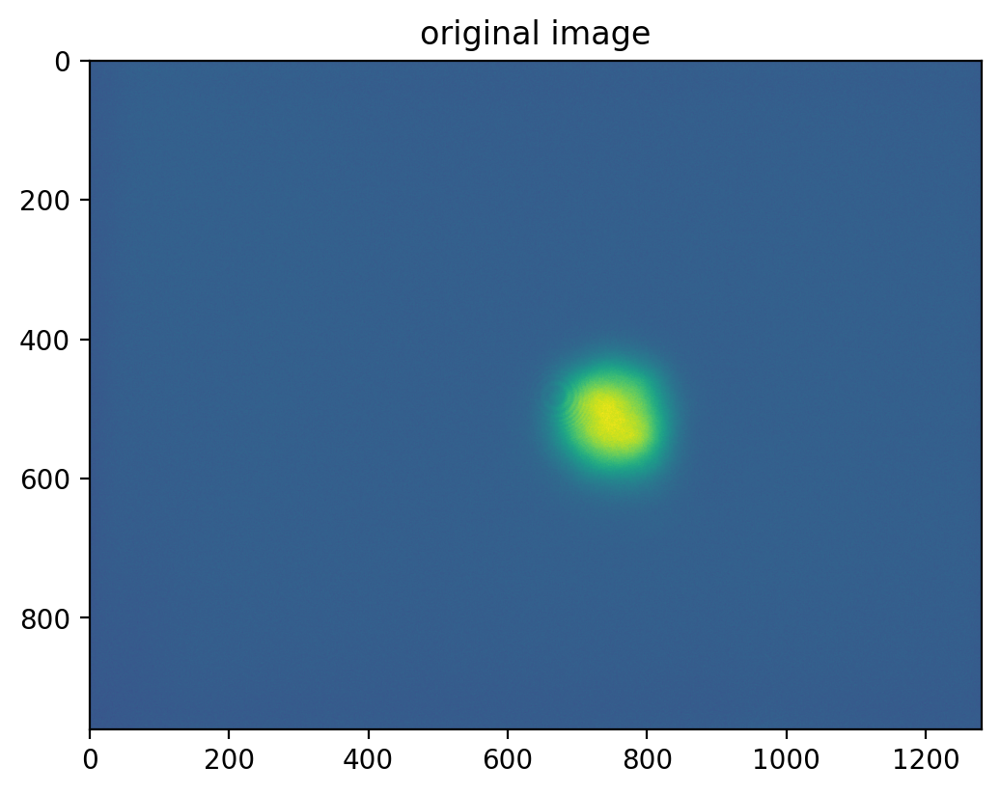

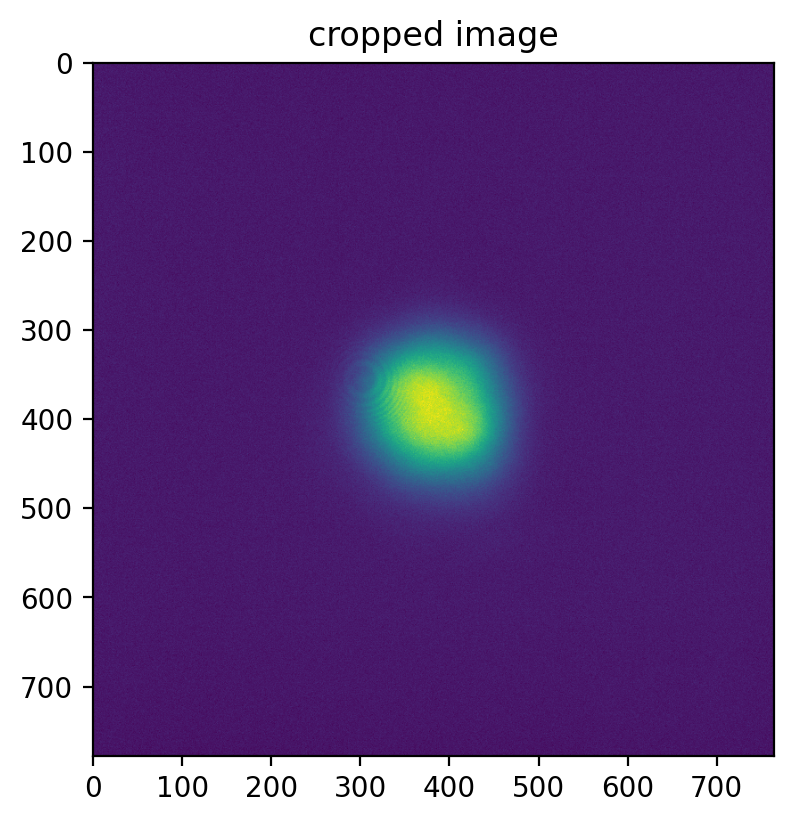

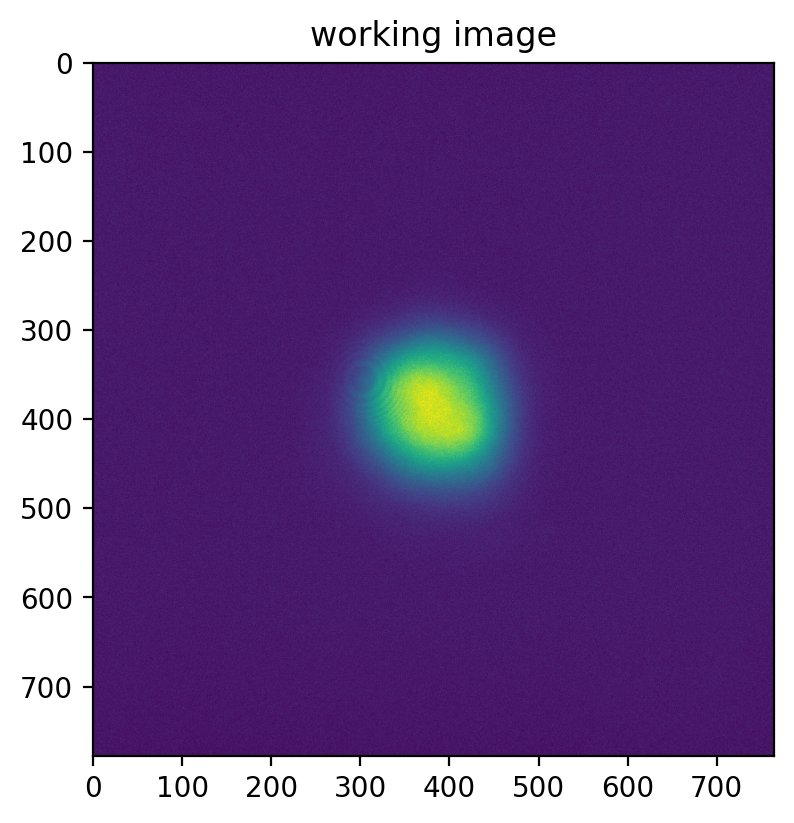

D_MINOR= 180.38004824869873
[231.28055387 535.52064153] [142.89927933 635.67786341] [613.41407106 153.38712434] [247.27891113 531.29823161]
[-570.45016437  570.45016437] [-923.95984515  923.95984515]
[ 862.55052509 -862.55052509] [-532.5362259  532.5362259]


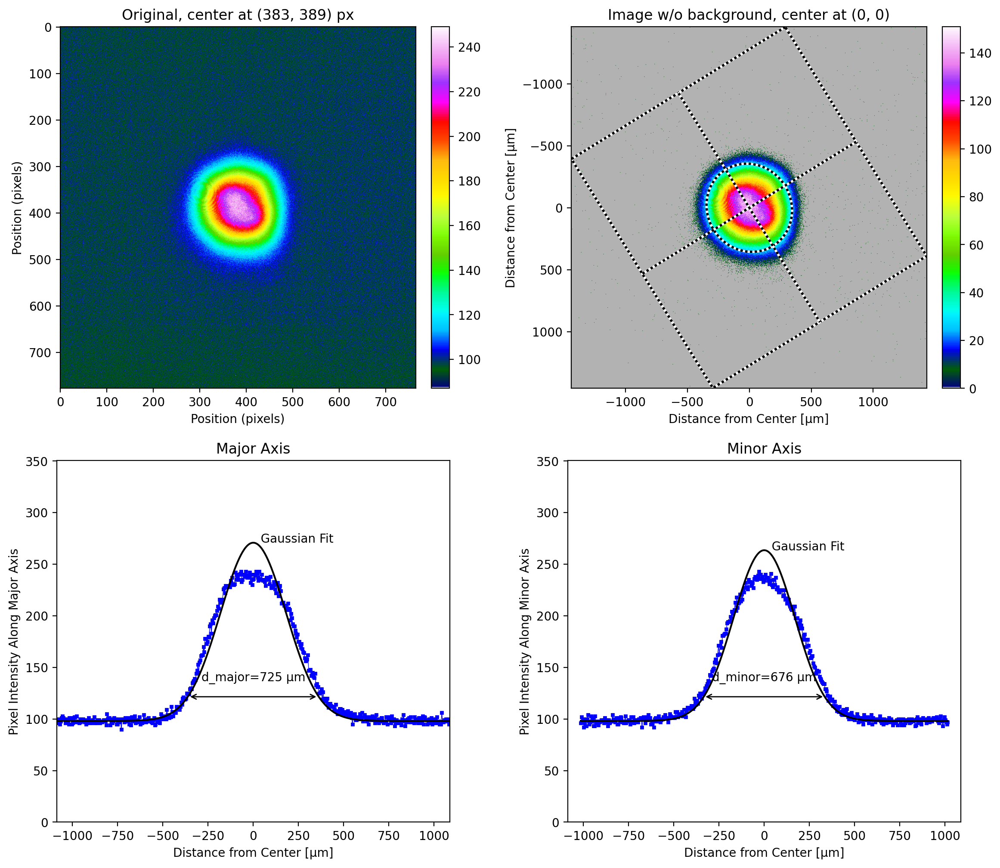

In [7]:
lbs.plot_image_analysis(test_img[15], pixel_size=pixel_size_µm, iso_noise=False, crop=True)

## TEM$_{00}$, TEM$_{01}$, TEM$_{02}$ Images

This shows what happens with higher order mode laser beams.  There are three images for each beam type taken at different distances along the optical axis.

In [8]:
# read in all the images
z = np.array([[140, 200, 300], [100, 200, 300], [100, 200, 300]])  # mm

tem = np.empty_like(z, dtype=np.ndarray)
for i in range(z.shape[0]):
    for j in range(z.shape[1]):
        filename = repo + "TEM0%d_%dmm.pgm" % (i, z[i, j])
        # 12 bit images but padded with four zero bits
        tem[i, j] = iio.imread(filename) >> 4

Plot the images and their fits.  Notice that the rectangles are cropped in some cases.  

[542.54578983 857.32323896] [385.57716643 403.90120158] [707.87813785 691.99089095] [258.28051068 531.19785734]
[-0.59020772  0.59020772] [-0.03435757  0.03435757]
[ 0.02978859 -0.02978859] [-0.51172002  0.51172002]
[496.05876799 783.45633178] [287.46872322 353.77922946] [670.14425961 609.37084016] [188.92438844 452.32356424]
[-0.53887043  0.53887043] [-0.1243322  0.1243322]
[ 0.11395016 -0.11395016] [-0.49387345  0.49387345]
[347.63911591 732.5074577 ] [ 44.26887792 200.77824382] [604.10070355 476.04587005] [-34.92468876 279.9718105 ]
[-0.72162814  0.72162814] [-0.29345506  0.29345506]
[ 0.24010281 -0.24010281] [-0.59043094  0.59043094]
[518.26053168 937.23688719] [672.86855949 583.88939274] [695.36406389 760.13335498] [475.88933995 780.86861229]
[-0.78558067  0.78558067] [ 0.16683594 -0.16683594]
[-0.12144242  0.12144242] [-0.57183614  0.57183614]
[444.67185671 829.27721759] [587.20391318 558.45747551] [625.80844762 648.14062668] [423.43695238 722.22443632]
[-0.72113505  0.72113505] 

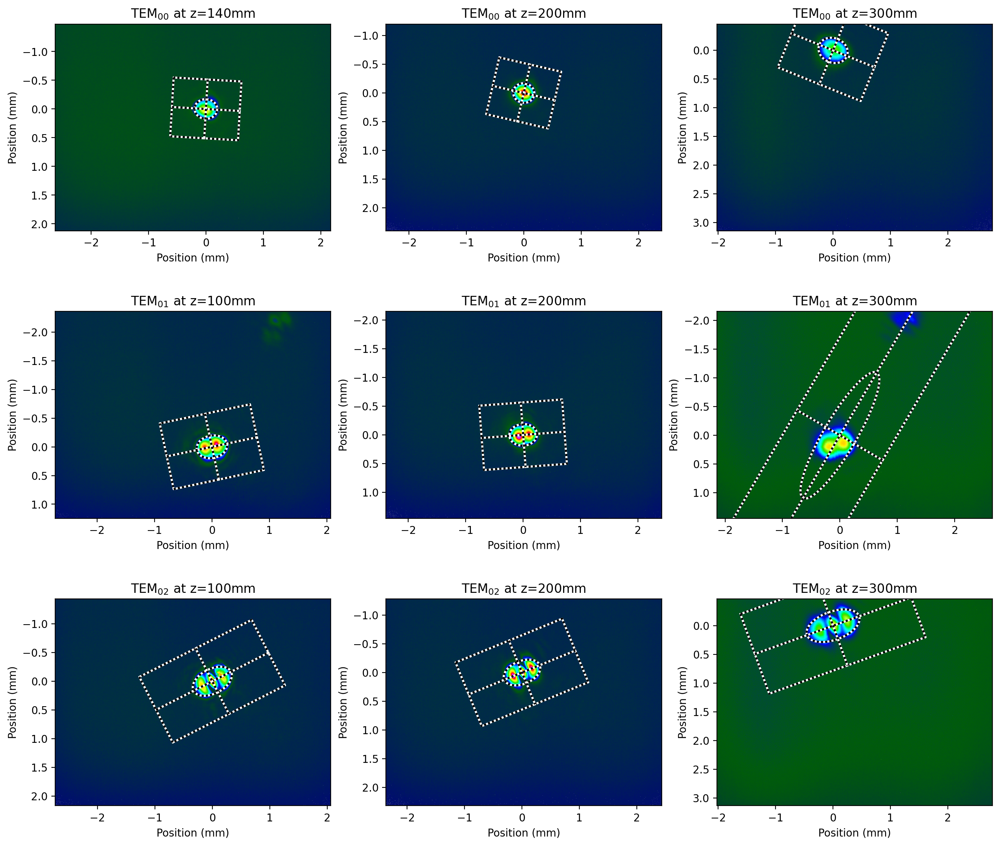

In [9]:
# figure out maximum so all color values match across images
vmax = 0
for i in range(3):
    for j in range(3):
        vmax = max(tem[i, j].max(), vmax)

plt.subplots(3, 3, figsize=(16, 14))
for i in range(3):
    for j in range(3):
        plt.subplot(3, 3, i * 3 + j + 1)
        lbs.plot_image_and_fit(
            tem[i, j], pixel_size_µm / 1000, vmax=vmax, units="mm", iso_noise=False, crop=False
        )
        plt.title("TEM$_{0%d}$ at z=%dmm" % (i, z[i, j]))

plt.show()

### Fit to TEM$_{02}$ beam

Close examination of the higher order mode at 100mm, shows very plausible results.

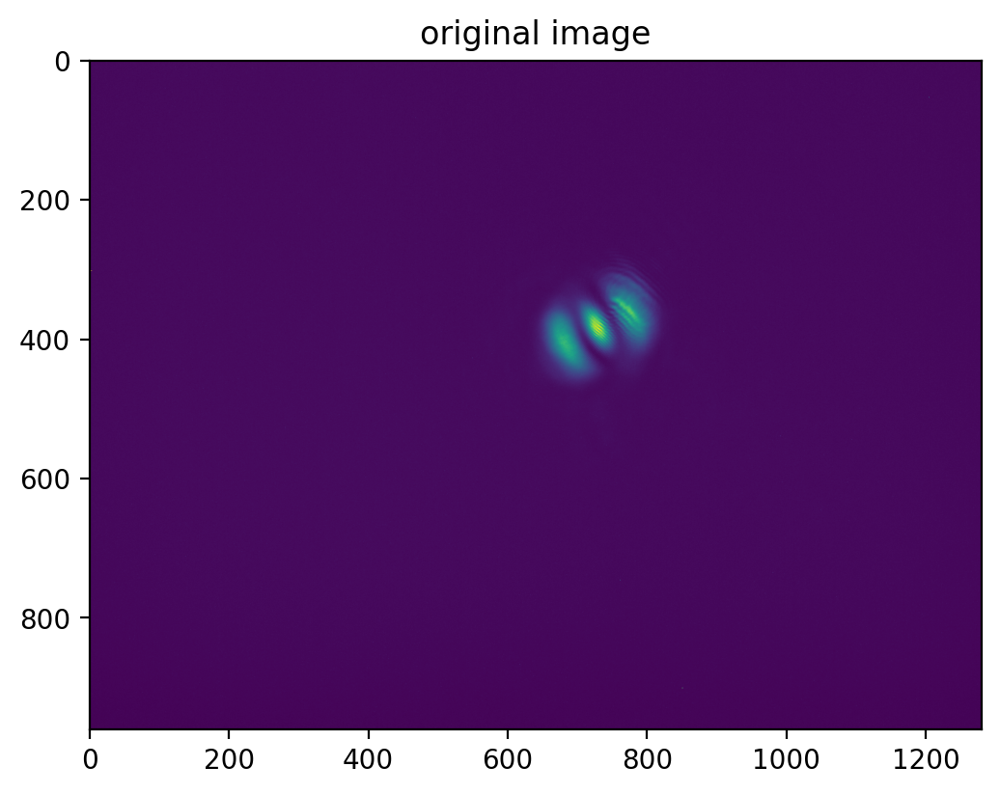

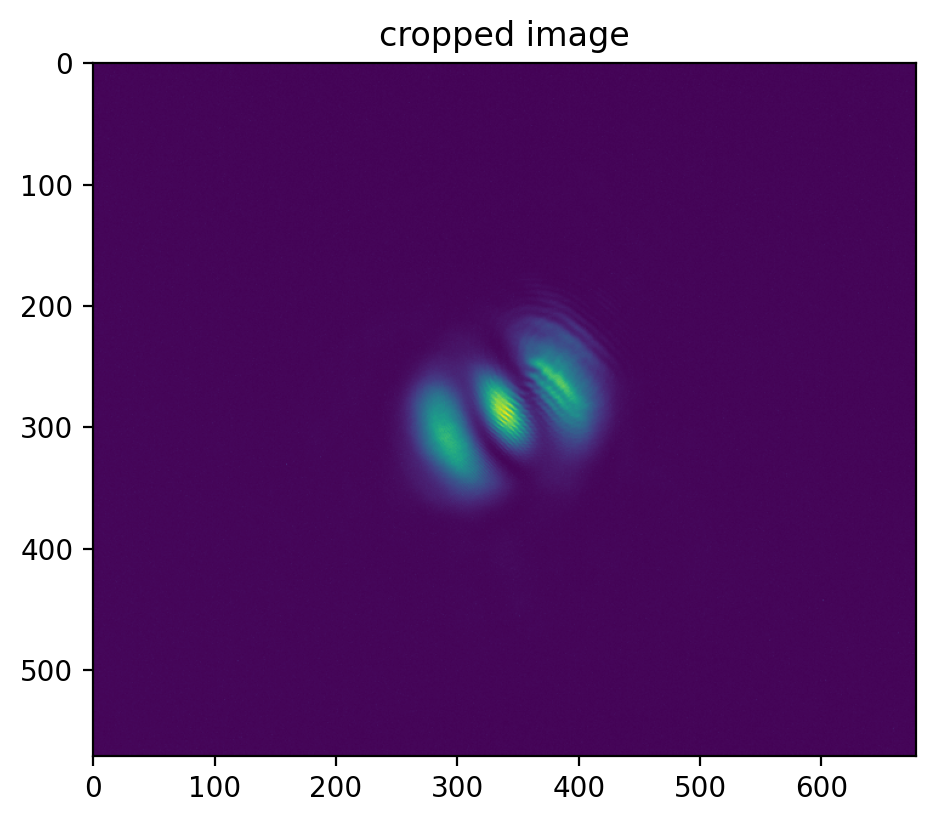

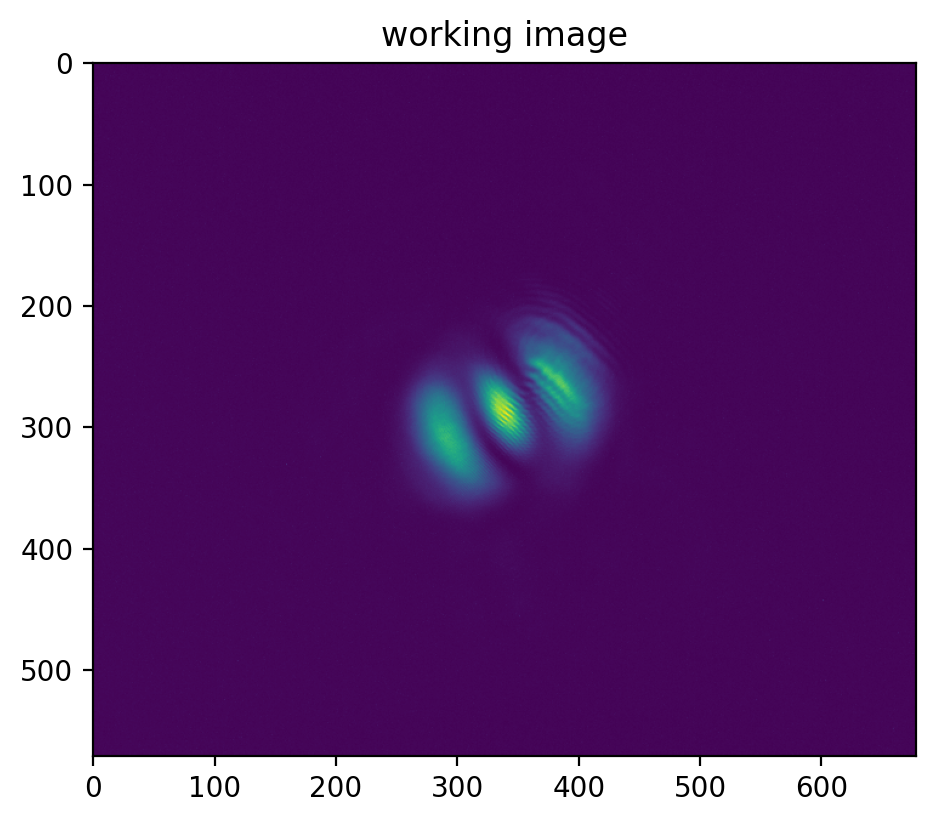

D_MINOR= 114.03970198075157
[ 78.72817038 600.25079343] [418.4925744  153.28282747] [262.06395026 416.91501355] [133.63399676 438.14140511]
[-260.76131153  260.76131153] [ 132.60487347 -132.60487347]
[-77.42553164  77.42553164] [-152.25370418  152.25370418]


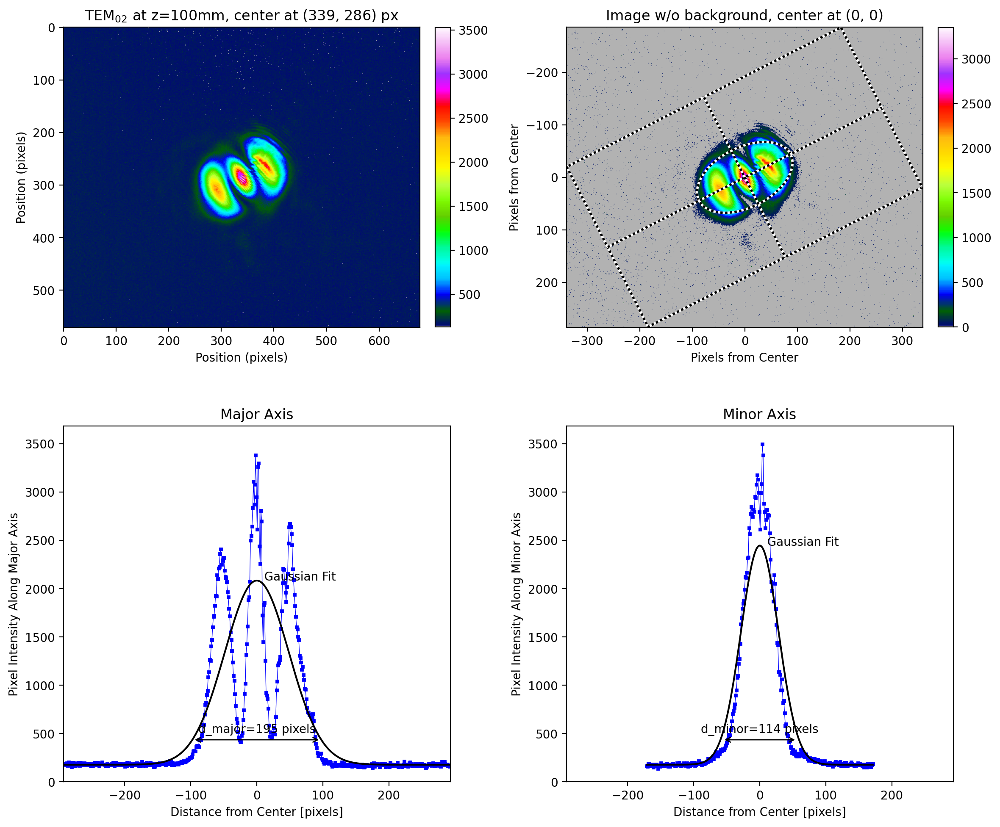

In [10]:
lbs.plot_image_analysis(tem[2, 0], title=r"TEM$_{02}$ at z=100mm", iso_noise=False, crop=True)

### Cropped integration area

However the TEM$_{02}$ beam at 300mm, has much poorer results.  This is because the beam was not centered in the image and therefore the integration rectangle (3x beam diameter) extended outside the image.  The integration area is cropped and so the integration to find the beam center is unbalanced.

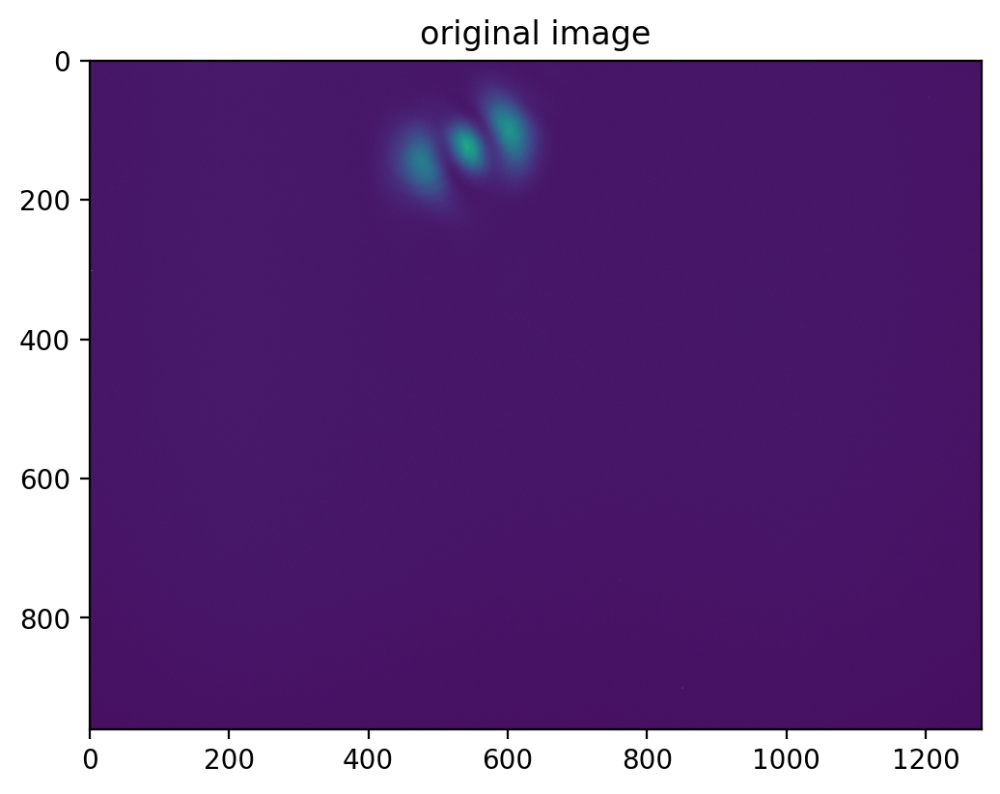

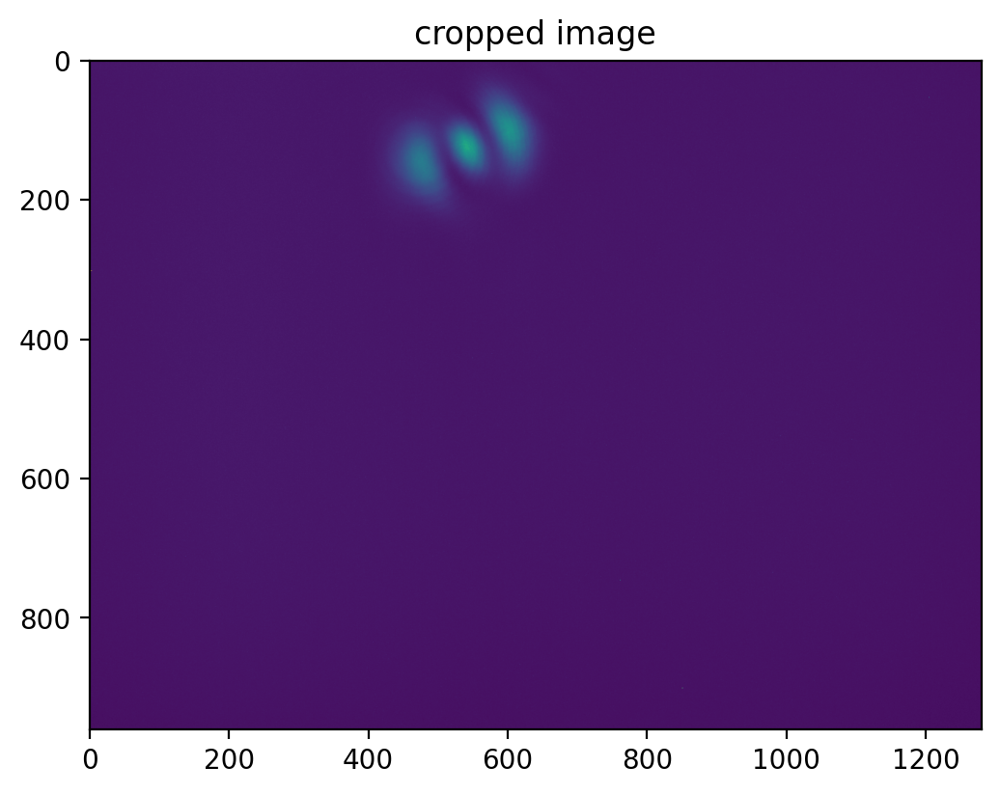

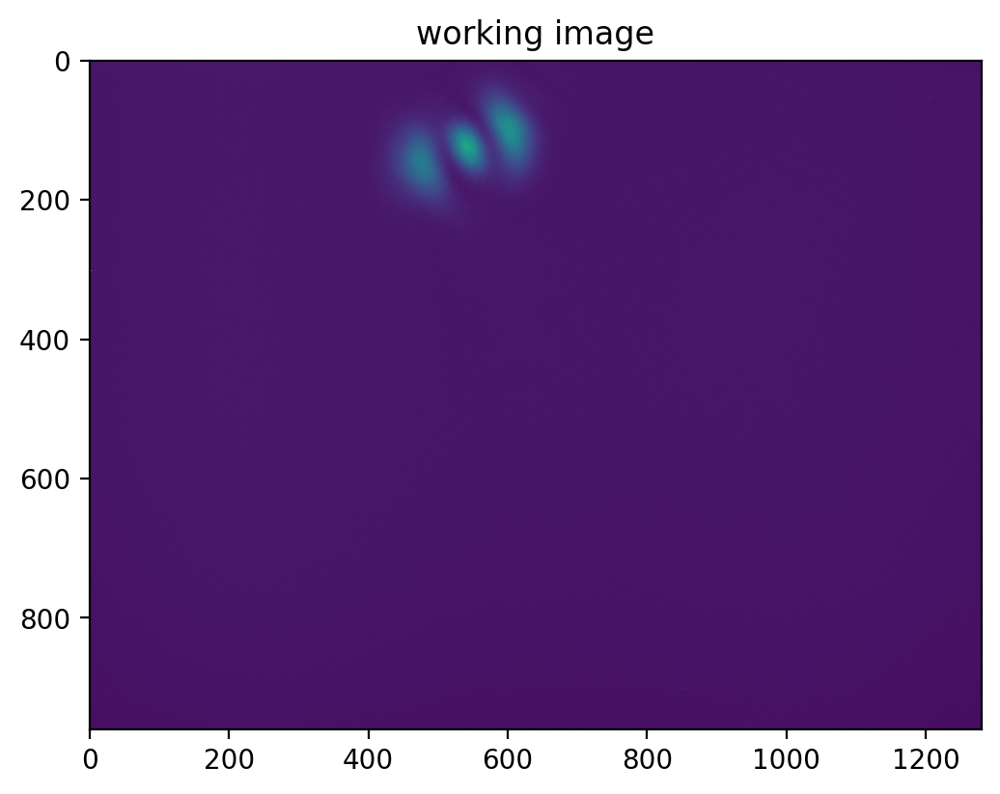

D_MINOR= 131.3252721514406
[176.92860719 902.9664492 ] [255.08310352  -7.29542324] [473.0819066  606.81314978] [-61.13262603 308.92030631]
[-1361.32095377  1361.32095377] [ 491.95973767 -491.95973767]
[-250.74608097  250.74608097] [-693.84924813  693.84924813]


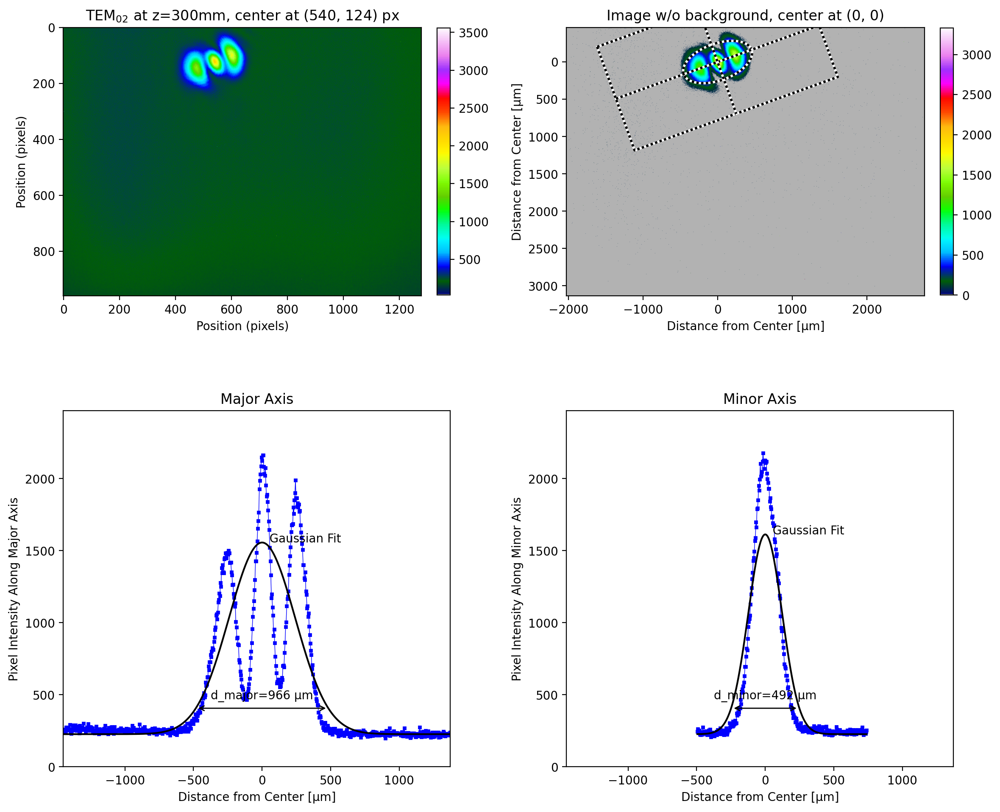

In [11]:
lbs.plot_image_analysis(tem[2, 2], pixel_size=pixel_size_µm, title=r"TEM$_{02}$ at z=300mm", iso_noise=False)